# <p style="background-color:#56BBD1;font-family:newtimeroman;color:#2E3035;font-size:150%;text-align:center;border-radius:10px 10px;">Scikit-learn - Generated datasets</p>


In this project, I will explain the types of data that can be artificially generated using Scikit-learn. I'll also show the important paramters and in most cases provide GIFs ilustrating some of their effects. You might be asking: "what's the importance of learning this?". Well, if you work with data, learning how to generate fake datasets in a simple and **reproducible** way can aid you in understanding the inner workings and limitations of many data analysis and modeling techniques.


<a id='top'></a>
<div class="list-group" id="list-tab" role="tablist">
<p style="background-color:#56BBD1;font-family:newtimeroman;color:#2E3035;font-size:150%;text-align:center;border-radius:10px 10px;">TABLE OF CONTENTS</p>   

* [1. CLUSTERING](#1)
    
* [2. SINGLE-LABEL CLASSIFICATION](#2)
    
* [3. MULTI-LABEL CLASSIFICATION](#3)
    
* [4. BICLUSTERING AND COCLUSTERING](#4)
    
* [5. LINEAR REGRESSION](#5) 
      
* [6. NONLINEAR REGRESSION](#6)
    
* [7. MANIFOLD GENERATION](#7)
    
* [8. GENERATORS FOR DECOMPOSITION](#8)
    
* [9. CONCLUSION](#9)
    
* [10. REFERENCES](#10)


In [1]:
import os
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
from matplotlib import rc
import matplotlib.animation as animation
import seaborn as sns

from sklearn import datasets
from sklearn.decomposition import PCA
from sklearn.linear_model import LinearRegression
from sklearn.neural_network import MLPRegressor
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.pipeline import make_pipeline

sns.set_style('whitegrid', {'legend.frameon':True, 'legend.facecolor': 'white'})
rc('animation', html='jshtml')

<a id="1"></a>
# <p style="background-color:#56BBD1;font-family:newtimeroman;color:#2E3035;font-size:150%;text-align:center;border-radius:10px 10px;">CLUSTERING</p>

## **<span style="font-size:150%"> make_blobs</span>**

### What it is

This is the bread and butter dataset generator for clustering. This function generates one or multiples sets of points for clustering. The points are isotropic (identical in all directions) following a Gaussian distribution. What makes this function distinct is the ability to generate easy to visualize blobs of data points in N dimensions.

### Important parameters

- n_samples [int or array-like]: If the argument is an Int, it is the total number of points generated divided among the clusters. If the argument is an array, each element of the sequence is the number of points per cluster.
- n_features [int]: Dimensions od the dataset (2D, 3D...)
- center [int or array-like]: How many blobs to generate (if Int) or the the center of each blob (ir array-like)
- return_centers [bool]: If True, returns the center of each cluster
- cluster_std [float or array-like]: Standard deviation of the clusters.

In [2]:
data1, labels1, centers1 = datasets.make_blobs(n_samples=1000, n_features=2, centers=3, cluster_std=1.0, center_box=(-10.0, 10.0), shuffle=True, random_state=42, return_centers=True)
df1 = pd.DataFrame(np.hstack([data1, labels1.reshape(-1,1)]), columns=[f"f{i}" for i in range(data1.shape[1])] + ['class'])
centers_df1 = pd.DataFrame(np.hstack([centers1, np.arange(len(centers1)).reshape(-1,1)]), columns=[f"f{i}" for i in range(data1.shape[1])] + ['class'])

p = sns.jointplot(data=df1, x="f0", y="f1", hue='class', palette=sns.color_palette("hls", df1['class'].nunique()))
plt.close()

In [3]:
total_frames = 5
fig, axes = plt.subplots(1, 4, figsize=(25, 5))

def plot_blobs(i):
    
    n_samples = [10, 100, 1000, 10000, 100000][i]
    centers = [2, 4, 6, 8, 10][i]
    cluster_std = [1, 1.5, 2, 3, 4, 5][i]
    center_box = [(-1.0, 1.0), (-4.0, 4.0), (-8.0, 8.0), (-15.0, 15.0), (-30.0, 30.0)][i]
    bbox = dict(boxstyle="square", ec=(1., 0.5, 0.5), fc=(1., 0.8, 0.8))
    
    lim_list = [(-15, 15), (-15, 15), (-15, 15), center_box]
    title_list = [f"Plot 1 [n_samples = {n_samples}]", f"Plot 2 [centers = {centers}]", f"Plot 3 [cluster_std = {cluster_std}]", f"Plot 4 [center_box = {center_box}]"]
    for ax in axes:
        ax.clear()
        
    data1, labels1, centers1 = datasets.make_blobs(n_samples=n_samples, n_features=2, centers=3, cluster_std=1.0, center_box=(-10.0, 10.0), shuffle=True, random_state=42, return_centers=True)
    df1 = pd.DataFrame(np.hstack([data1, labels1.reshape(-1,1)]), columns=[f"f{i}" for i in range(data1.shape[1])] + ['class'])
    centers_df1 = pd.DataFrame(np.hstack([centers1, np.arange(len(centers1)).reshape(-1,1)]), columns=[f"f{i}" for i in range(data1.shape[1])] + ['class'])
    
    data2, labels2, centers2 = datasets.make_blobs(n_samples=500, n_features=2, centers=centers, cluster_std=1.0, center_box=(-10.0, 10.0), shuffle=True, random_state=42, return_centers=True)
    df2 = pd.DataFrame(np.hstack([data2, labels2.reshape(-1,1)]), columns=[f"f{i}" for i in range(data2.shape[1])] + ['class'])
    centers_df2 = pd.DataFrame(np.hstack([centers2, np.arange(len(centers2)).reshape(-1,1)]), columns=[f"f{i}" for i in range(data2.shape[1])] + ['class'])
    
    data3, labels3, centers3 = datasets.make_blobs(n_samples=500, n_features=2, centers=3, cluster_std=cluster_std, center_box=(-10.0, 10.0), shuffle=True, random_state=42, return_centers=True)
    df3 = pd.DataFrame(np.hstack([data3, labels3.reshape(-1,1)]), columns=[f"f{i}" for i in range(data3.shape[1])] + ['class'])
    centers_df3 = pd.DataFrame(np.hstack([centers3, np.arange(len(centers3)).reshape(-1,1)]), columns=[f"f{i}" for i in range(data3.shape[1])] + ['class'])
    
    data4, labels4, centers4 = datasets.make_blobs(n_samples=500, n_features=2, centers=3, cluster_std=1.0, center_box=center_box, shuffle=True, random_state=42, return_centers=True)
    df4 = pd.DataFrame(np.hstack([data4, labels4.reshape(-1,1)]), columns=[f"f{i}" for i in range(data4.shape[1])] + ['class'])
    centers_df4 = pd.DataFrame(np.hstack([centers4, np.arange(len(centers4)).reshape(-1,1)]), columns=[f"f{i}" for i in range(data4.shape[1])] + ['class'])
    
    sns.scatterplot(x='f0', y='f1', hue='class', data=df1, ax=axes[0], palette=sns.color_palette("hls", df1['class'].nunique()))
    sns.scatterplot(x='f0', y='f1', data=centers_df1, ax=axes[0], color='black', label="center")
    axes[0].text(x=0.5, y=0.02, s=f"n_samples={n_samples}, n_features=2, centers=3,\ncluster_std=1.0, center_box=(-10.0, 10.0)", ha="center", va="bottom", transform=axes[0].transAxes, bbox=bbox, fontsize=13)
    
    sns.scatterplot(x='f0', y='f1', hue='class', data=df2, ax=axes[1], palette=sns.color_palette("hls", df2['class'].nunique()))
    sns.scatterplot(x='f0', y='f1', data=centers_df2, ax=axes[1], color='black', label="center")
    axes[1].text(x=0.5, y=0.02, s=f"n_samples=500, n_features=2, centers={centers},\ncluster_std=1.0, center_box=(-10.0, 10.0)", ha="center", va="bottom", transform=axes[1].transAxes, bbox=bbox, fontsize=13)
    
    sns.scatterplot(x='f0', y='f1', hue='class', data=df3, ax=axes[2], palette=sns.color_palette("hls", df3['class'].nunique()))
    sns.scatterplot(x='f0', y='f1', data=centers_df3, ax=axes[2], color='black', label="center")
    axes[2].text(x=0.5, y=0.02, s=f"n_samples=500, n_features=2, centers=3,\ncluster_std={cluster_std}, center_box=(-10.0, 10.0)", ha="center", va="bottom", transform=axes[2].transAxes, bbox=bbox, fontsize=13)
    
    sns.scatterplot(x='f0', y='f1', hue='class', data=df4, ax=axes[3], palette=sns.color_palette("hls", df4['class'].nunique()))
    sns.scatterplot(x='f0', y='f1', data=centers_df4, ax=axes[3], color='black', label="center")
    axes[3].text(x=0.5, y=0.02, s=f"n_samples=500, n_features=2, centers=3,\ncluster_std=1.0, center_box={center_box}", ha="center", va="bottom", transform=axes[3].transAxes, bbox=bbox, fontsize=13)
    
    for ax, lim, title in zip(axes, lim_list, title_list):
        ax.set_xlim(lim[0], lim[1])
        ax.set_ylim(lim[0], lim[1])
        ax.legend(loc='upper right')
        ax.set_title(title, fontsize=18)
        ax.set_xlabel('$f_1$', fontsize=22)
        ax.set_ylabel('$f_2$', fontsize=22)
    axes[3].tick_params(axis="both", colors="red", labelsize=14)
    
# Code to prevent a static image from being generated from this cell
plt.close()
# plot_blobs(2)

anim = animation.FuncAnimation(fig, plot_blobs, frames=total_frames, interval=1000, blit=False)
anim

In [4]:
anim.save('make_blobs.gif', writer='imagemagick')

## **<span style="font-size:150%"> make_moons</span>**

### What it is

Generates two interleaving half circles. This functions is very interesting as a testbed for clustering algorithms, due to the distribution of the datapoints. Also, the data is easy to visualize and to generate. However, the generated data is only two dimensional.

Unlike make_blobs, the generated data is convex set of points. This is very interesting to test the limitations of some types of clustering algorithms, such as centroid-based algorithms.

### Important parameters

- n_samples [int or tuple of shape (2,)]: If the argument is an Int, it is the total number of points generated. If the argument is a tuple, each element corresponds to the number of points in each moon.
- noise [float]: Standard deviation of Gaussian noise added to the data.

In [5]:
total_frames = 5
fig, axes = plt.subplots(1, 3, figsize=(16, 4))

def plot_moons(i):
    
    n_samples1 = [10, 100, 1000, 10000, 100000][i]
    n_samples2 = [(500, 500), (600, 400), (700, 300), (800, 200), (900, 100)][i]
    noise = [0, 0.03, 0.06, 0.09, 0.12][i]
    
    title_list = [f"Plot 1 [n_samples = {n_samples1}]", f"Plot 2 [n_samples = {n_samples2}]", f"Plot 3 [noise = {noise}]"]
    for ax, title in zip(axes, title_list):
        ax.clear()
        ax.legend(loc='upper right')
        ax.set_title(title, fontsize=18)
        ax.set_xlabel('$f_1$', fontsize=18)
        ax.set_ylabel('$f_2$', fontsize=18)
    bbox = dict(boxstyle="square", ec=(1., 0.5, 0.5), fc=(1., 0.8, 0.8))
        
    data1, labels1 = datasets.make_moons(n_samples=n_samples1, shuffle=True, noise=0.04, random_state=42)
    df1 = pd.DataFrame(np.hstack([data1, labels1.reshape(-1,1)]), columns=["f0", "f1", "class"])
    
    data2, labels2 = datasets.make_moons(n_samples=n_samples2, shuffle=True, noise=0.04, random_state=42)
    df2 = pd.DataFrame(np.hstack([data2, labels2.reshape(-1,1)]), columns=["f0", "f1", "class"])
    
    data3, labels3 = datasets.make_moons(n_samples=1000, shuffle=True, noise=noise, random_state=42)
    df3 = pd.DataFrame(np.hstack([data3, labels3.reshape(-1,1)]), columns=["f0", "f1", "class"])
    
    sns.scatterplot(x='f0', y='f1', hue='class', data=df1, ax=axes[0], palette=sns.color_palette("hls", df1['class'].nunique()))
    sns.scatterplot(x='f0', y='f1', hue='class', data=df2, ax=axes[1], palette=sns.color_palette("hls", df2['class'].nunique()))    
    sns.scatterplot(x='f0', y='f1', hue='class', data=df3, ax=axes[2], palette=sns.color_palette("hls", df3['class'].nunique()))
    
    axes[0].text(x=0.5, y=0.02, s=f"n_samples={n_samples1}, noise=0.04", ha="center", va="bottom", transform=axes[0].transAxes, bbox=bbox, fontsize=13)
    axes[1].text(x=0.5, y=0.02, s=f"n_samples={n_samples2}, noise=0.04", ha="center", va="bottom", transform=axes[1].transAxes, bbox=bbox, fontsize=13)
    axes[2].text(x=0.5, y=0.02, s=f"n_samples=1000, noise={noise}", ha="center", va="bottom", transform=axes[2].transAxes, bbox=bbox, fontsize=13)
    
# Code to prevent a static image from being generated from this cell
plt.close()
# plot_moons(4)

anim = animation.FuncAnimation(fig, plot_moons, frames=total_frames, interval=1000, blit=False)
anim

In [6]:
anim.save('make_moons.gif', writer='imagemagick')

## **<span style="font-size:150%"> make_circles</span>**

### What it is

Generates two concentric rings, that is, two 2D circles one inside the other. This functions if very similar to make_moons and generates only 2D toy datasets.

Still, unlike make_moons, this function have an additional parameter to control named factor, which manipulates the distance between the rings.

### Important parameters

- n_samples [int or tuple of shape (2,)]: If the argument is an Int, it is the total number of points generated. If the argument is a tuple, each element corresponds to the number of points in the outer and inner circle.
- noise [float]: Standard deviation of Gaussian noise added to the data.
- factor [float]: Scale the distance between the inner and outer circles.

In [7]:
total_frames = 5
fig, axes = plt.subplots(1, 3, figsize=(16, 4))

def plot_circles(i):
    
    n_samples = [10, 100, 1000, 10000, 100000][i]
    noise = [0, 0.03, 0.06, 0.09, 0.12][i]
    factor = [0, 0.2, 0.5, 0.7, 0.9][i]
    
    title_list = [f"Plot 1 [n_samples = {n_samples}]", f"Plot 2 [noise = {noise}]", f"Plot 3 [factor = {factor}]"]
    for ax, title in zip(axes, title_list):
        ax.clear()
        ax.legend(loc='upper right')
        ax.set_title(title, fontsize=18)
        ax.set_xlabel('$f_1$', fontsize=18)
        ax.set_ylabel('$f_2$', fontsize=18)
    bbox = dict(boxstyle="square", ec=(1., 0.5, 0.5), fc=(1., 0.8, 0.8))
        
    data1, labels1 = datasets.make_circles(n_samples=n_samples, noise=0.03, random_state=42, factor=0.6)
    df1 = pd.DataFrame(np.hstack([data1, labels1.reshape(-1,1)]), columns=["f0", "f1", "class"])
    
    data2, labels2 = datasets.make_circles(n_samples=500, noise=noise, random_state=42, factor=0.6)
    df2 = pd.DataFrame(np.hstack([data2, labels2.reshape(-1,1)]), columns=["f0", "f1", "class"])
    
    data3, labels3 = datasets.make_circles(n_samples=500, noise=0.03, random_state=42, factor=factor)
    df3 = pd.DataFrame(np.hstack([data3, labels3.reshape(-1,1)]), columns=["f0", "f1", "class"])
    
    sns.scatterplot(x='f0', y='f1', hue='class', data=df1, ax=axes[0], palette=sns.color_palette("hls", df1['class'].nunique()))
    sns.scatterplot(x='f0', y='f1', hue='class', data=df2, ax=axes[1], palette=sns.color_palette("hls", df2['class'].nunique()))    
    sns.scatterplot(x='f0', y='f1', hue='class', data=df3, ax=axes[2], palette=sns.color_palette("hls", df3['class'].nunique()))
    
    axes[0].text(x=0.5, y=0.02, s=f"n_samples={n_samples}, noise=0.03, factor=0.6", ha="center", va="bottom", transform=axes[0].transAxes, bbox=bbox, fontsize=13)
    axes[1].text(x=0.5, y=0.02, s=f"n_samples=500, noise={noise}, factor=0.6", ha="center", va="bottom", transform=axes[1].transAxes, bbox=bbox, fontsize=13)
    axes[2].text(x=0.5, y=0.02, s=f"n_samples=500, noise=0.03, factor={factor}", ha="center", va="bottom", transform=axes[2].transAxes, bbox=bbox, fontsize=13)
    
# Code to prevent a static image from being generated from this cell
plt.close()
# plot_circles(-1)

anim = animation.FuncAnimation(fig, plot_circles, frames=total_frames, interval=1000, blit=False)
anim

In [8]:
anim.save('make_circles.gif', writer='imagemagick')

<a id="2"></a>
# <p style="background-color:#56BBD1;font-family:newtimeroman;color:#2E3035;font-size:150%;text-align:center;border-radius:10px 10px;">SINGLE-LABEL CLASSIFICATION</p>

## **<span style="font-size:150%"> make_classification</span>**

### What is is

This functions generates a MADELON [2] dataset, which is a two-class classification problem with continuous input variables in a N-dimensional space.

What makes this problem possibly difficult is the multivariate nature of the dataset and it's non-linearity.

However, the function have many parameters that can be adjusted in order to create simpler or harder problems.

This initially creates clusters of points normally distributed (std=1) about vertices of an n_informative-dimensional hypercube with sides of length 2*class_sep and assigns an equal number of clusters to each class. It introduces interdependence between these features and adds various types of further noise to the data.

### Important parameters

- n_samples [int]: The number of samples in the generated dataset.
- n_features [int]: Total number of features, that is, the dimensionality of the problem.
- n_informative [int]: Number of informative features.
- n_redundant [int]: Number of redundant features, generated as random linear combinations of the informative features.
- n_repeated [int]: Number of duplicated features, drawn from either the informative or redundant features.
- n_classes [int]: Number of classes/labels.
- flip_y [float]: The fraction of samples assigned with a random class. The larger this value, the harder the classification.
- class_sep [float]: Larger values makes the classification problem easier. This parameter multiplies the hypercube size, and since the clusters/classes are located in the vertices of this hypercube, it influences directly the problem's difficulty.

There are many other parameters that can be used to spice the classification problems. You can check them out in the documentation.

In [9]:
data, labels = datasets.make_classification(n_samples=1000, n_features=8, n_informative=2, n_redundant=0, n_repeated=0, n_classes=2, n_clusters_per_class=1, weights=None, flip_y=0.00, class_sep=50.0, hypercube=True, shift=0.0, scale=1.0, random_state=42)
df = pd.DataFrame(np.hstack([data, labels.reshape(-1,1)]), columns=[f"f{i}" for i in range(data.shape[1])] + ['class'])

fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(25, 5))

pd.plotting.parallel_coordinates(df, 'class', color=sns.color_palette("hls", df['class'].nunique()), ax=axes[0])
pd.plotting.radviz(df, 'class', color=sns.color_palette("hls", df['class'].nunique()), ax=axes[1]) #, edgecolor='gray', s=90, alpha=0.5
pd.plotting.andrews_curves(df, 'class', color=sns.color_palette("hls", df['class'].nunique()), ax=axes[2])
axes[0].set_title("Parallel Coordinates Plot", fontsize=20)
axes[1].set_title("Radviz Plot", fontsize=20)
axes[2].set_title("Andrews Curves Plot", fontsize=20)
# plt.show()
plt.close()

In [10]:
total_frames = 8
fig, axes = plt.subplots(nrows=2, ncols=5, figsize=(24, 6))

def plot_classifications(i):
    
    n_informative = [1, 2, 3, 4, 5, 6, 7, 8][i]
    n_repeated = [0, 1, 2, 3, 4, 5, 6, 7][i]
    n_redundant = [0, 1, 2, 3, 4, 5, 6, 7][i]
    n_classes = [1, 2, 3, 4, 5, 6, 7, 8][i]
    n_clusters_per_class = [1, 2, 3, 4, 5, 6, 7, 8][i]
        
    title_list = [f"Plot 1 [n_informative={n_informative}]", f"Plot 2 [n_repeated={n_repeated}]", f"Plot 3 [n_redundant={n_redundant}]", f"Plot 4 [n_classes={n_classes}]", f"Plot 5 [n_clusters_per_class={n_clusters_per_class}]"]
    for ax in axes.flatten():
        ax.clear()
        
    for col in range(5):
        axes[0][col].set_title(title_list[col], fontsize=18)
    
    data1, labels1 = datasets.make_classification(n_samples=1000, n_features=8, n_informative=n_informative, n_redundant=0, n_repeated=0, n_classes=2, n_clusters_per_class=1, class_sep=50.0, random_state=42)
    df1 = pd.DataFrame(np.hstack([data1, labels1.reshape(-1,1)]), columns=[f"f{j}" for j in range(data1.shape[1])] + ['class'])
    
    data2, labels2 = datasets.make_classification(n_samples=1000, n_features=8, n_informative=1, n_redundant=0, n_repeated=n_repeated, n_classes=2, n_clusters_per_class=1, class_sep=50.0, random_state=42)
    df2 = pd.DataFrame(np.hstack([data2, labels2.reshape(-1,1)]), columns=[f"f{j}" for j in range(data2.shape[1])] + ['class'])
    
    data3, labels3 = datasets.make_classification(n_samples=1000, n_features=8, n_informative=1, n_redundant=n_redundant, n_repeated=0, n_classes=2, n_clusters_per_class=1, class_sep=50.0, random_state=42)
    df3 = pd.DataFrame(np.hstack([data3, labels3.reshape(-1,1)]), columns=[f"f{j}" for j in range(data3.shape[1])] + ['class'])
    
    data4, labels4 = datasets.make_classification(n_samples=1000, n_features=8, n_informative=n_informative, n_redundant=0, n_repeated=0, n_classes=n_classes, n_clusters_per_class=1, class_sep=50.0, random_state=42)
    df4 = pd.DataFrame(np.hstack([data4, labels4.reshape(-1,1)]), columns=[f"f{j}" for j in range(data4.shape[1])] + ['class'])
    
    data5, labels5 = datasets.make_classification(n_samples=1000, n_features=8, n_informative=n_informative, n_redundant=0, n_repeated=0, n_classes=2, n_clusters_per_class=n_clusters_per_class, class_sep=50.0, random_state=42)
    df5 = pd.DataFrame(np.hstack([data5, labels5.reshape(-1,1)]), columns=[f"f{j}" for j in range(data5.shape[1])] + ['class'])

    pd.plotting.radviz(df1, 'class', color=sns.color_palette("hls", df1['class'].nunique()), ax=axes[0][0])
    pd.plotting.parallel_coordinates(df1, 'class', color=sns.color_palette("hls", df1['class'].nunique()), ax=axes[1][0])

    pd.plotting.radviz(df2, 'class', color=sns.color_palette("hls", df2['class'].nunique()), ax=axes[0][1])
    pd.plotting.parallel_coordinates(df2, 'class', color=sns.color_palette("hls", df2['class'].nunique()), ax=axes[1][1])
    
    pd.plotting.radviz(df3, 'class', color=sns.color_palette("hls", df3['class'].nunique()), ax=axes[0][2])
    pd.plotting.parallel_coordinates(df3, 'class', color=sns.color_palette("hls", df3['class'].nunique()), ax=axes[1][2])
    
    pd.plotting.radviz(df4, 'class', color=sns.color_palette("hls", df4['class'].nunique()), ax=axes[0][3])
    pd.plotting.parallel_coordinates(df4, 'class', color=sns.color_palette("hls", df4['class'].nunique()), ax=axes[1][3])
    
    pd.plotting.radviz(df5, 'class', color=sns.color_palette("hls", df5['class'].nunique()), ax=axes[0][4])
    pd.plotting.parallel_coordinates(df5, 'class', color=sns.color_palette("hls", df5['class'].nunique()), ax=axes[1][4])
    
# Code to prevent a static image from being generated from this cell
plt.close()
# plot_classifications(1)

anim = animation.FuncAnimation(fig, plot_classifications, frames=total_frames, interval=1000, blit=False)
anim

/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/misc.py:178: RuntimeWarning: invalid value encountered in true_divide
  y = (s * row_).sum(axis=0) / row.sum()


In [11]:
anim.save('make_classification.gif', writer='imagemagick')

/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/misc.py:178: RuntimeWarning: invalid value encountered in true_divide
  y = (s * row_).sum(axis=0) / row.sum()


## **<span style="font-size:150%"> make_gaussian_quantiles</span>**

### What it is

This classification dataset is created by sampling a multi-dimensional isotropic gaussian distribution. Each class is separated by nested concentric multi-dimensional spheres (as can be seen in the scatter plots) with roughly equal number of samples, sampled by quantile.

### Important parameters

- n_samples [int]: Number of samples in the generated dataset.
- n_features [int]: Number of features, that is, the dimensionality of the problem's inputs.
- n_classes [int]: Number of classes.
- mean [array of shape (n_features,)]: The mean of the multi-dimensional normal distribution. Basically shifts the data values.
- cov [float]: Basically changes the interval or scale of the data.

In [12]:
fig, axes = plt.subplots(nrows=2, ncols=4, figsize=(20, 7))
# plt.tight_layout()

for i in range(4):
    X, Y = datasets.make_gaussian_quantiles(mean=None, cov=1.0, n_samples=1000, n_features=2, n_classes=i+1, shuffle=True, random_state=42)
    df = pd.DataFrame(np.hstack([X, Y.reshape(-1,1)]), columns=[f"f{i}" for i in range(X.shape[1])] + ['class'])
    sns.scatterplot(x='f0', y='f1', hue='class', data=df, palette=sns.color_palette("hls", df['class'].nunique()), ax=axes[0][i])
    sns.histplot(df, x='f1', hue='class', palette=sns.color_palette("hls", df['class'].nunique()), ax=axes[1][i])
    
# plt.show()
plt.close()

In [13]:
total_frames = 16
fig, axes = plt.subplots(nrows=3, ncols=3, figsize=(10, 10))

def plot_gaussian_quantiles(i):
    
    for ax in axes.flatten():
        ax.clear()
    
    n_samples = [10, 100, 1000, 10000][i%4]
    n_classes = [1, 2, 3, 4][i//4]
    
    data, labels = datasets.make_gaussian_quantiles(mean=np.array([1, 40, 800]), cov=1.0, n_samples=n_samples, n_features=3, n_classes=n_classes, shuffle=True, random_state=42)
    df = pd.DataFrame(np.hstack([data, labels.reshape(-1,1)]), columns=[f"f{i}" for i in range(data.shape[1])] + ['class'])

    sns.histplot(df, x='f0', hue='class', palette=sns.color_palette("hls", df['class'].nunique()), ax=axes[0][0], legend=False)
    sns.histplot(df, x='f1', hue='class', palette=sns.color_palette("hls", df['class'].nunique()), ax=axes[1][1])
    sns.histplot(df, x='f2', hue='class', palette=sns.color_palette("hls", df['class'].nunique()), ax=axes[2][2], legend=False)

    sns.scatterplot(data=df, x='f0', y='f1', hue='class', palette=sns.color_palette("hls", df['class'].nunique()), ax=axes[1][0], legend=False)
    sns.scatterplot(data=df, x='f0', y='f2', hue='class', palette=sns.color_palette("hls", df['class'].nunique()), ax=axes[2][0], legend=False)
    sns.scatterplot(data=df, x='f1', y='f2', hue='class', palette=sns.color_palette("hls", df['class'].nunique()), ax=axes[2][1], legend=False)

    for row, col in zip([0, 1], [0, 1]):
        axes[row][col].set_ylabel('')
        axes[row][col].set_xlabel('')
    axes[2][2].set_ylabel('')
    axes[1][0].set_xlabel('')

    for row, col in zip([0, 0, 1], [1, 2, 2]):
        axes[row][col].set_visible(False)
    
# Code to prevent a static image from being generated from this cell
plt.close()
# plot_gaussian_quantiles(3)

anim = animation.FuncAnimation(fig, plot_gaussian_quantiles, frames=total_frames, interval=1000, blit=False)
anim

In [14]:
anim.save('make_gaussian_quantile.gif', writer='imagemagick')

## **<span style="font-size:150%"> make_hastie_10_2</span>**

### What it is

Well, 10 inputs and 2 outputs. VERY similar to the make_gaussian_quantiles for 2 classes and default mean and covariance. You can see these similarities in the figure below, illustrating the scatter plot and histogram for hastie_10_2 and gaussian_quantiles.

Still, mathematically the target is defined as:

#### $y[i] = 1$ if $\sum X[i]^2 > 9.34$ else $-1$

Basically the only important parameter is the number of samples to be generated (n_samples).

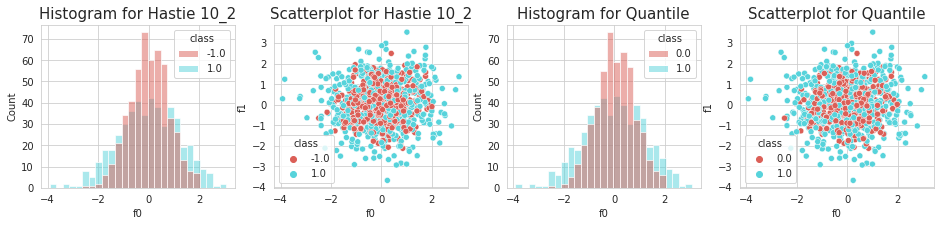

In [15]:
fig, axes = plt.subplots(1, 4, figsize=(16, 3))

data1, labels1 = datasets.make_hastie_10_2(n_samples=1000, random_state=42)
df1 = pd.DataFrame(np.hstack([data1, labels1.reshape(-1,1)]), columns=[f"f{i}" for i in range(data1.shape[1])] + ['class'])
sns.histplot(x='f0', hue='class', data=df1, ax=axes[0], palette=sns.color_palette("hls", df1['class'].nunique()))
sns.scatterplot(x='f0', y='f1', hue='class', data=df1, ax=axes[1], palette=sns.color_palette("hls", df1['class'].nunique()))

data2, labels2 = datasets.make_gaussian_quantiles(n_samples=1000, n_features=10, n_classes=2, random_state=42)
df2 = pd.DataFrame(np.hstack([data2, labels2.reshape(-1,1)]), columns=[f"f{i}" for i in range(data2.shape[1])] + ['class'])
sns.histplot(x='f0', hue='class', data=df2, ax=axes[2], palette=sns.color_palette("hls", df2['class'].nunique()))
sns.scatterplot(x='f0', y='f1', hue='class', data=df2, ax=axes[3], palette=sns.color_palette("hls", df2['class'].nunique()))

axes[0].set_title("Histogram for Hastie 10_2", fontsize=15)
axes[1].set_title("Scatterplot for Hastie 10_2", fontsize=15)
axes[2].set_title("Histogram for Quantile", fontsize=15)
axes[3].set_title("Scatterplot for Quantile", fontsize=15)
plt.show()

<a id="3"></a>
# <p style="background-color:#56BBD1;font-family:newtimeroman;color:#2E3035;font-size:150%;text-align:center;border-radius:10px 10px;">MULTI-LABEL CLASSIFICATION</p>

## **<span style="font-size:150%"> make_multilabel_classification</span>**

### What it is

 In a multi-label classification, each instance can be assigned with multiple labels.
 
 For contrast, in a single-label classification problem, an instance can be labeled as Book or Movie, but not both.
 In a multi-label classification however, an instance can have multiple labels, such as Romance, Comedy and Drama.
 
 Thus, multi-label classification are widely used in many areas where multiple outputs can be expected, such as:
 - Image classification and object detection
 - Building a recommendation system
 - Social media targeting
 - Detecting different subjects on text
 - Recognizing sentiments on text
 
As will be seen in the image below, a multi-label classification can be converted (either for visualization or modeling) to a single-label multi-classification problem by treating each label set as a single class.

### Important parameters

- n_samples [int]: Number of samples in the generated dataset.
- n_features [int]: Number of features, that is, the dimensionality of the problem's inputs.
- n_classes [int]: Number of classes.
- n_labels [int]: Average number of labels per instance.
- allow_unlabeled [bool]: Allow instances without classes.
- sparse [bool]: If True, returns a sparse feature matrix.

In [16]:
n_classes = 3
X, Y = datasets.make_multilabel_classification(n_samples=300, n_features=20, n_classes=n_classes, n_labels=2, length=50, allow_unlabeled=True, sparse=False, return_indicator='dense', return_distributions=False, random_state=42)
df = pd.DataFrame(np.hstack([X, Y]), columns=[f"f{i}" for i in range(X.shape[1])] + [f"class {i}" for i in range(Y.shape[1])])

palette = sns.color_palette("hls", 2**n_classes)
unique_colors = np.array(palette.as_hex())

data_embedded_df = pd.DataFrame(PCA(n_components=2).fit_transform(X), columns=['F0', 'F1'])
df = pd.concat([df, data_embedded_df], axis=1)
df['color'] = unique_colors.take((Y[:, :n_classes] * np.array([2**n for n in range(n_classes)])).sum(axis=1))
df['classes'] = df[[f'class {i}' for i in range(n_classes)]].apply(lambda row: str(row.values), axis=1)

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(15,4))
sns.scatterplot(data=df, x='F0', y='F1', hue='class 0', style="class 1", size='class 2', sizes=(50, 200), ax=axes[0])
sns.scatterplot(data=df, x='F0', y='F1', hue='classes', palette=palette, s=200, ax=axes[1])

title_list = ["Plot 1 - Multilabel represented through color, size and markers", "Plot 2 - Multilabel represented using only colors"]
for ax, title in zip(axes, title_list):
        ax.legend(loc='upper right')
        ax.set_title(title, fontsize=14)
        ax.set_xlabel('$F_1$', fontsize=18)
        ax.set_ylabel('$F_2$', fontsize=18)

# plt.show()
plt.close()

In [17]:
total_frames = 3
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(15,4))

def plot_multilabel_classification(i):
    n_classes = i+1
    X, Y = datasets.make_multilabel_classification(n_samples=300, n_features=20, n_classes=3, n_labels=2, length=50, allow_unlabeled=True, random_state=42)
    df = pd.DataFrame(np.hstack([X, Y]), columns=[f"f{i}" for i in range(X.shape[1])] + [f"class {i}" for i in range(Y.shape[1])])

    data_embedded_df = pd.DataFrame(PCA(n_components=2).fit_transform(X))
    data_embedded_df.columns = ['F0', 'F1']
    
    for i in range(Y.shape[1]):
        data_embedded_df[f"class {i}"] = df[f"class {i}"]
        
    val_f1_min, val_f1_max = np.min(data_embedded_df['F1'])-1, np.max(data_embedded_df['F1'])+1
    val_f0_min, val_f0_max = np.min(data_embedded_df['F0'])-1, np.max(data_embedded_df['F0'])+1

    palette = sns.color_palette("hls", 2**3)
    unique_colors = np.array(palette.as_hex())
    df['color'] = unique_colors.take((Y[:, :3] * np.array([2**n for n in range(3)])).sum(axis=1))
    df['classes'] = df[['class 0', 'class 1', 'class 2']].apply(lambda row: str(row.values), axis=1)
    df['classes_order'] = (Y[:, :3] * np.array([2**n for n in range(3)])).sum(axis=1)

    classes_order = ['[0. 0. 0.]', '[1. 0. 0.]', '[0. 1. 0.]', '[1. 1. 0.]', '[0. 0. 1.]', '[1. 0. 1.]', '[0. 1. 1.]', '[1. 1. 1.]']

    for col in ['class 0', 'class 1', 'class 2', 'color', 'classes', 'classes_order']:
        data_embedded_df[col] = df[col]

    title_list = ["Plot 1 - Multilabel represented through color, size and markers", "Plot 2 - Multilabel represented using only colors"]
    for ax in axes:
        ax.clear()
        
    if n_classes == 1:
        data_embedded_df = data_embedded_df[data_embedded_df['class 1'] == 0]
        data_embedded_df = data_embedded_df[data_embedded_df['class 2'] == 0]
        palette = palette[:2]
        classes_order = classes_order[:2]
        sns.scatterplot(data=data_embedded_df, x='F0', y='F1', hue='class 0', s=200, ax=axes[0])
    if n_classes == 2:
        data_embedded_df = data_embedded_df[data_embedded_df['class 2'] == 0]
        palette = palette[:4]
        classes_order = classes_order[:4]
        sns.scatterplot(data=data_embedded_df, x='F0', y='F1', hue='class 0', style="class 1", s=200, ax=axes[0])
    if n_classes == 3:
        sns.scatterplot(data=data_embedded_df, x='F0', y='F1', hue='class 0', style="class 1", size='class 2', sizes=(50, 200), ax=axes[0])

    sns.scatterplot(data=data_embedded_df, x='F0', y='F1', hue='classes', hue_order=classes_order, palette=palette, s=200, ax=axes[1])

    for ax, title in zip(axes, title_list):
        ax.set_xlim(val_f0_min, val_f0_max)
        ax.set_ylim(val_f1_min, val_f1_max)
        ax.legend(loc='upper right')
        ax.set_title(title, fontsize=14)
        ax.set_xlabel('$F_1$', fontsize=18)
        ax.set_ylabel('$F_2$', fontsize=18)
    
    
# Code to prevent a static image from being generated from this cell
plt.close()
# plot_multilabel_classification(0)

anim = animation.FuncAnimation(fig, plot_multilabel_classification, frames=total_frames, interval=2000, blit=False)
anim

In [18]:
anim.save('make_multilabel_classification.gif', writer='imagemagick')

As can be seen above, multi-label problems can be visualized as a multi-class with single label where each label corresponds to a unique color.

<a id="4"></a>
# <p style="background-color:#56BBD1;font-family:newtimeroman;color:#2E3035;font-size:150%;text-align:center;border-radius:10px 10px;">BICLUSTERING AND COCLUSTERING</p>

Bisclustering or coclustering is a technique to simultaneously cluster the rows and columns of a matrix by applying similarity criteria. The algorithms used for these tasks cluster objects and attributes, which enalbes the discovery of bi or coclusters.

Although biclustering and coclustering are similar, these tasks are not the same. Just as multi-label classification can be though of as a generalization of single-label classification, coclustering can be thought of as a generalization of biclustering.

Applications of this technique includes:

- Data mining of textual data (Objects = documents, Variables = words)
- Data mining of biological and biomedical data (Objects = genes, Variables = conditions or experiments)
- Data mining of marketing data (Objects = documents, Variables = words)

## **<span style="font-size:150%"> make_biclusters and make_checkerboard</span>**

### What it is

- make_biclusters generate dataset for biclustering. The dataset, when organized, resembles a diagonal matrix, that is, a set of data where the clusters are localized on or near the diagonal of the data table. In a biclustering dataset, each row and column belongs to exactly one bicluster.

- make_checkerboard generate a dataset for coclustering. Unlike biclustering, the clusters of data can be anywhere on the table, not only on or near the diagonal. In the checkerboard dataset, each row belongs to all columns clusters, and each column belongs to all row clusters.

### Important parameters

- shape [iterable of shape (n_rows, ncols)]: The shape of the data, or, the number of rows and columns of the generated data.
- n_clusters[int]: Number of clusters.
- noise [float]: Standard deviation of gaussian noise added to the data.
- minval and maxval [int]: Minimum and maximum value of a bicluster, respectively.
- shuffle [bool]: If True, the generated dataset is shuffled.

In [19]:
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(8, 4))

data1, rows1, columns1 = datasets.make_biclusters(shape=(300, 300), n_clusters=5, noise=5, shuffle=False, random_state=42)
data2, rows2, columns2 = datasets.make_checkerboard(shape=(300, 300), n_clusters=5, noise=5.0, shuffle=False, random_state=42)

axes[0].matshow(data1, cmap=plt.cm.Blues)
axes[1].matshow(data2, cmap=plt.cm.Blues)
axes[0].set_title("Biclustering Plot")
axes[1].set_title("Checkerboard Plot")
# plt.show()
plt.close()

In [20]:
total_frames = 6
fig, axes = plt.subplots(nrows=2, ncols=4, figsize=(15, 8))

def plot_biclustering_checkerboard(i):
    
    shape = [(10, 10), (25, 25), (50, 50), (100, 100), (150, 150), (200, 200)][i]
    n_clusters = [2, 4, 8, 15, 20, 30][i]
    noise = [0, 5, 15, 30, 50, 100][i]
    shuffle = [False, False, False, True, True, True][i]
        
    title_list = [f"Plot 1A [shape={shape}]", f"Plot 2A [n_clusters={n_clusters}]", f"Plot 3A [noise={noise}]", f"Plot 4A [shuffle={shuffle}]", f"Plot 1B [shape={shape}]", f"Plot 2B [n_clusters={n_clusters}]", f"Plot 3B [noise={noise}]", f"Plot 4B [shuffle={shuffle}]"]
    for ax, title in zip(axes.flatten(), title_list):
        ax.clear()
        ax.set_title(title, fontsize=16)
    
    data1, rows1, columns1 = datasets.make_biclusters(shape=shape, n_clusters=5, noise=5, shuffle=False, random_state=42)
    data2, rows2, columns2 = datasets.make_biclusters(shape=(300, 300), n_clusters=n_clusters, noise=5, shuffle=False, random_state=42)
    data3, rows3, columns3 = datasets.make_biclusters(shape=(300, 300), n_clusters=5, noise=noise, shuffle=False, random_state=42)
    data4, rows4, columns4 = datasets.make_biclusters(shape=(300, 300), n_clusters=5, noise=5, shuffle=shuffle, random_state=42)
    
    data5, rows5, columns5 = datasets.make_checkerboard(shape=shape, n_clusters=5, noise=5.0, shuffle=False, random_state=42)
    data6, rows6, columns6 = datasets.make_checkerboard(shape=(300, 300), n_clusters=n_clusters, noise=5.0, shuffle=False, random_state=42)
    data7, rows7, columns7 = datasets.make_checkerboard(shape=(300, 300), n_clusters=5, noise=noise, shuffle=False, random_state=42)
    data8, rows8, columns8 = datasets.make_checkerboard(shape=(300, 300), n_clusters=5, noise=5.0, shuffle=shuffle, random_state=42)
    
    axes[0][0].matshow(data1, cmap=plt.cm.Blues)
    axes[0][1].matshow(data2, cmap=plt.cm.Blues)
    axes[0][2].matshow(data3, cmap=plt.cm.Blues)
    axes[0][3].matshow(data4, cmap=plt.cm.Blues)
    axes[1][0].matshow(data5, cmap=plt.cm.Blues)
    axes[1][1].matshow(data6, cmap=plt.cm.Blues)
    axes[1][2].matshow(data7, cmap=plt.cm.Blues)
    axes[1][3].matshow(data8, cmap=plt.cm.Blues)
    
    axes[0][0].tick_params(axis="both", colors="red", labelsize=14)
    axes[1][0].tick_params(axis="both", colors="red", labelsize=14)
    
    for ax in axes.flatten():
        ax.grid(False)
    
# Code to prevent a static image from being generated from this cell
plt.close()
# plot_biclustering_checkerboard(0)

anim = animation.FuncAnimation(fig, plot_biclustering_checkerboard, frames=total_frames, interval=1000, blit=False)
anim

In [21]:
anim.save('make_biclustering.gif', writer='imagemagick')

<a id="5"></a>
# <p style="background-color:#56BBD1;font-family:newtimeroman;color:#2E3035;font-size:150%;text-align:center;border-radius:10px 10px;">LINEAR REGRESSION</p>

The goal of regression analysis is to estimate the relationship between dependent variables (also called outcome or response) and independent variables (features or predictors). Unlike classification, the outcome can assume continuous and unbounded values.

A regression equation is linear if the parameters used to model the dependent variable are linear, even if the curve being modeled itself isn't linear. The linearity is in the parameters.

## **<span style="font-size:150%"> make_regression</span>**

### What it is

Generates a random linear regression problem with a lot of customization.

Several aspects of this regression problem can be adjusted, such as number of targets (singular or multiple regression problem), bias, number of informative and redundant features, the rank of the regression matrix generated, presence of noise, among other things.

The major selling point of this function is the customization and the ability to generate multiple regression outputs. Consequently, this can be used to test the effectiveness and limitations of regression algorithms and dimensionality reduction algorithms.

### Important parameters

- n_samples [int]: Number of samples
- n_features [int]: Number of features or the dimensionality of the generated data's inputs.
- n_informative [int]: Number of features actually used to build the linear model used to generate the output.
- n_targets [int]: Number of regression targets or the dimensionality of the generate data's output.
- bias [float]: The bias in the underlying linear model.
- noise [float]: Standard deviation of the gaussian noise added to the output.

## **<span style="font-size:150%"> make_sparse_uncorrelated</span>**

### What it is

This method generates a random regression problem with sparse uncorrelated features, where only the first 4 features are informative and the remaining ones are useless. The usage of this functions is very simple due to the few number of parameters necessary to generate the data. This also means, however, that unlike make_regression, the diversity of datasets that can be generated from this function is very low with few customization.

The regression output is given as:

#### $y(X) = X[:, 0] + 2X[:, 1] - 2X[:, 2] - 1.5X[:, 3]$

### Important parameters

- n_samples [int]: Number of samples
- n_features [int]: Number of features

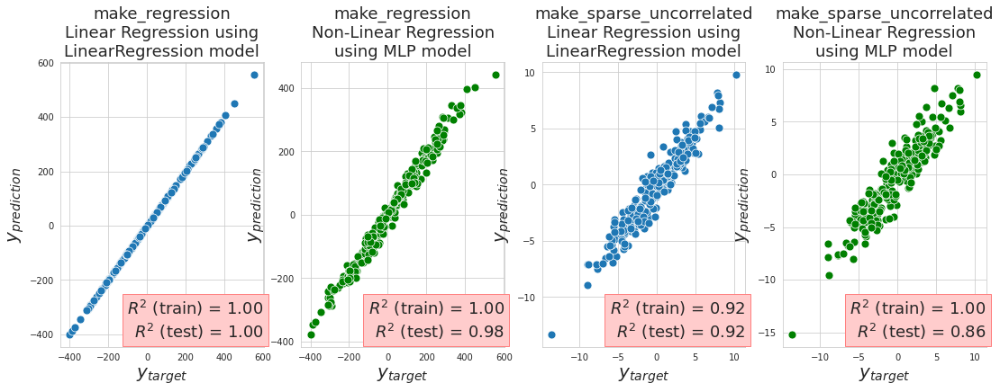

In [22]:
generators = [datasets.make_regression, datasets.make_sparse_uncorrelated]
titles = ["make_regression", "make_sparse_uncorrelated"]

fig, axes = plt.subplots(nrows=1, ncols=len(generators)*2, figsize=(15,5))
plt.tight_layout()

for i, generator in enumerate(generators):
    X, y = generator(n_samples=1000)
    X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=0)

    lin_regr = LinearRegression()
    lin_regr.fit(X_train, y_train)
    lin_r2_train, lin_r2_test = lin_regr.score(X_train, y_train), lin_regr.score(X_test, y_test)
    lin_y_hat = lin_regr.predict(X_test)
    
    nlin_regr = make_pipeline(StandardScaler(), MLPRegressor(random_state=1, max_iter=10000))
    nlin_regr.fit(X_train, y_train)
    nlin_r2_train, nlin_r2_test = nlin_regr.score(X_train, y_train), nlin_regr.score(X_test, y_test)
    nlin_y_hat = nlin_regr.predict(X_test)

    sns.scatterplot(x=y_test, y=lin_y_hat,  ax=axes[2*i], s=80)
    sns.scatterplot(x=y_test, y=nlin_y_hat, ax=axes[2*i+1], s=80, color='green')

    bbox = dict(boxstyle="square", ec=(1., 0.5, 0.5), fc=(1., 0.8, 0.8))
    axes[2*i].text(x=1.0, y=0.02, s=f"$R^2$ (train) = {lin_r2_train:.2f}\n$R^2$ (test) = {lin_r2_test:.2f}", ha="right", va="bottom", transform=axes[2*i].transAxes, bbox=bbox, fontsize=18)
    axes[2*i+1].text(x=1.0, y=0.02, s=f"$R^2$ (train) = {nlin_r2_train:.2f}\n$R^2$ (test) = {nlin_r2_test:.2f}", ha="right", va="bottom", transform=axes[2*i+1].transAxes, bbox=bbox, fontsize=18)
    axes[2*i].set_title(f"{titles[i]}\nLinear Regression using\nLinearRegression model", fontsize=18)
    axes[2*i+1].set_title(f"{titles[i]}\nNon-Linear Regression\nusing MLP model", fontsize=18)
    axes[2*i].set_ylabel("$y_{prediction}$", fontsize=20)
    axes[2*i].set_xlabel("$y_{target}$", fontsize=20)
    axes[2*i+1].set_ylabel("$y_{prediction}$", fontsize=20)
    axes[2*i+1].set_xlabel("$y_{target}$", fontsize=20)

As can be seen, a simple linear regressor can outperform a Multi Layer Perceptron, since there is no need to use such a complex model. Although non-linear models such as Neural Networks, Random Forests and AdaBoost, among others, are in vogue nowadays, linear models still have their uses and their charm.

<a id="6"></a>
# <p style="background-color:#56BBD1;font-family:newtimeroman;color:#2E3035;font-size:150%;text-align:center;border-radius:10px 10px;">NONLINEAR REGRESSION</p>

So what is a nonlinear regression? Well, it is a regression that is not linear! Basically, if you remove the constraint that the parameters used in modeling must be linear, you have a nonlinear regression.

## **<span style="font-size:150%"> make_friedman (1, 2 and 3)</span>**

### What it is

Generate the Friedman #1, #2 or #3 regression problem.

Friedman1 is related by polynomial and sine transforms. Friedman 2 includes feature multiplication and reciprocation while Friedman3 uses an arctan transformation.

For Friedman #1 [3], inputs are independent features uniformly distributed on the inverval [0, 1] and only 5 features are used to compute y, which is given as follows:

#### $y(X) = 10 sin(\pi X_1 X_2) + 20 (X_3 - \frac{1}{2})^2 + 10 X_4 + 5 X_5 + noise$ (61)


For Friedman #2 [3], the data input's dimensionality is fixed such that there's only 4 independent features. The output y is given as:

#### $y(X) =  [X_1^2 + (X_2 X_3 - \frac{1}{X_2 X_4})^2]^{0.5} + noise $ (63a)

The inputs for Friedman #3 [3] are the same for Friedman #2, the only thing that changes is how $y$ is computed:

#### $y(X) = tan^{-1}( \frac{X_2 X_3 - \frac{1}{X_2 X_4}}{X_1}) + noise  $

where $X_1 = X[:, 0], X_2 = X[:, 1], X_3 = X[:, 2], X_4 = X[:, 3], X_5 = X[:, 4]$

### Important parameters

- n_samples [int]: Number of samples
- n_features [int]: Number of features, or, the dimensionality of the data's inputs (only available for friedman1)
- noise [float]: Standard deviation of gaussian noise added to the output.

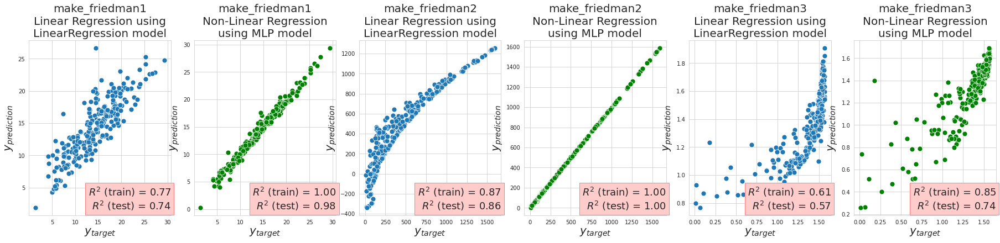

In [23]:
generators = [datasets.make_friedman1, datasets.make_friedman2, datasets.make_friedman3]
titles = ["make_friedman1", "make_friedman2", "make_friedman3"]

fig, axes = plt.subplots(nrows=1, ncols=len(generators)*2, figsize=(25,5))
plt.tight_layout()

for i, generator in enumerate(generators):
    X, y = generator(n_samples=1000)
    X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=0)

    lin_regr = LinearRegression()
    lin_regr.fit(X_train, y_train)
    lin_r2_train, lin_r2_test = lin_regr.score(X_train, y_train), lin_regr.score(X_test, y_test)
    lin_y_hat = lin_regr.predict(X_test)
    
    nlin_regr = make_pipeline(StandardScaler(), MLPRegressor(random_state=1, max_iter=10000))
    nlin_regr.fit(X_train, y_train)
    nlin_r2_train, nlin_r2_test = nlin_regr.score(X_train, y_train), nlin_regr.score(X_test, y_test)
    nlin_y_hat = nlin_regr.predict(X_test)

    sns.scatterplot(x=y_test, y=lin_y_hat,  ax=axes[2*i], s=80)
    sns.scatterplot(x=y_test, y=nlin_y_hat, ax=axes[2*i+1], s=80, color='green')

    bbox = dict(boxstyle="square", ec=(1., 0.5, 0.5), fc=(1., 0.8, 0.8))
    axes[2*i].text(x=1.0, y=0.02, s=f"$R^2$ (train) = {lin_r2_train:.2f}\n$R^2$ (test) = {lin_r2_test:.2f}", ha="right", va="bottom", transform=axes[2*i].transAxes, bbox=bbox, fontsize=18)
    axes[2*i+1].text(x=1.0, y=0.02, s=f"$R^2$ (train) = {nlin_r2_train:.2f}\n$R^2$ (test) = {nlin_r2_test:.2f}", ha="right", va="bottom", transform=axes[2*i+1].transAxes, bbox=bbox, fontsize=18)
    axes[2*i].set_title(f"{titles[i]}\nLinear Regression using\nLinearRegression model", fontsize=20)
    axes[2*i+1].set_title(f"{titles[i]}\nNon-Linear Regression\nusing MLP model", fontsize=20)
    axes[2*i].set_ylabel("$y_{prediction}$", fontsize=20)
    axes[2*i].set_xlabel("$y_{target}$", fontsize=20)
    axes[2*i+1].set_ylabel("$y_{prediction}$", fontsize=20)
    axes[2*i+1].set_xlabel("$y_{target}$", fontsize=20)

Now, here we can see the advantages of using non-linear models. A very simple Neural Network can significantly outperform linear models when it comes to non-linear regression datasets without overfitting. This comes at a cost though. Although this Neural Network only have 1 layer and 100 neurons and could be considered simple, it is much more complex than a linear model, and this can bring some disadvantages.

Still, by comparing the performance of common linear and non-linear models, it is possible to reach a conclusion regarding how complex our models need to be in order to achieve satisfactory results.

<a id="7"></a>
# <p style="background-color:#56BBD1;font-family:newtimeroman;color:#2E3035;font-size:150%;text-align:center;border-radius:10px 10px;">MANIFOLD GENERATION</p>

First, let's clear some things out of the way: a manifold is any structure that can be locally approximated as an Euclidean space.

I'll give you an example of this. The planet Earth is (almost) a 3D sphere, so it isn't euclidean. But from our perspective (tiny humans in a massive planet) it is flat, so it is euclidean. This seems contradictory, but it's all a matter of perspective and approximations. So, if we can move on the surface of the Earth as a 2D plane, this means that the third dimension (which makes the planet a 3D sphere) can be "reduced".

So basically, manifold datasets are used to test dimensionality reduction techniques that are not linear. How can we create such data? Simple, we create strange and complex 3D stuff!

## **<span style="font-size:150%"> make_s_curve and make_swiss_roll</span>**

### What it is

These functions basically create a 3D data commonly known as S Curve and Swiss Roll, because, well, they resemble a big S and a swiss roll.

There aren't many parameters used to generate the data, so the function's usage is quite simple.

### Important parameters

- n_samples [int]: Number of samples
- noise [float] : Standard deviation of gaussian noise added to the data

In [24]:
X, t = datasets.make_s_curve(n_samples=5000, noise=0.0, random_state=42)
df1 = pd.DataFrame(np.hstack([X, t.reshape(-1,1)]), columns=[f"f{i}" for i in range(X.shape[1])] + ['class'])

X, t = datasets.make_swiss_roll(n_samples=5000, noise=0.0, random_state=42)
df2 = pd.DataFrame(np.hstack([X, t.reshape(-1,1)]), columns=[f"f{i}" for i in range(X.shape[1])] + ['class'])

fig = plt.figure()

ax1 = fig.add_subplot(121, projection='3d')
ax1.scatter3D(df1['f0'], df1['f1'], df1['f2'], c=t, cmap=plt.cm.Spectral)
ax1.set_title('S Curve Plot')

ax2 = fig.add_subplot(122, projection='3d')
ax2.scatter3D(df2['f0'], df2['f1'], df2['f2'], c=t, cmap=plt.cm.Spectral)
ax2.set_title('Swiss Roll Plot')

# plt.show()
plt.close()

In [25]:
total_frames = 12*2*2

fig = plt.figure(figsize=(15,5))
ax1 = fig.add_subplot(141, projection='3d')
ax2 = fig.add_subplot(142, projection='3d')
ax3 = fig.add_subplot(143, projection='3d')
ax4 = fig.add_subplot(144, projection='3d')

def plot_s_curve_swiss_roll(i):

    angle = np.linspace(start=0, stop=360, num=total_frames, endpoint=False)[i]
    noise1 = np.linspace(start=0, stop=0.5, num=total_frames, endpoint=False)[i]
    noise2 = np.linspace(start=0, stop=2, num=total_frames, endpoint=False)[i]
    
    title_list = ["Plot 1A - S Curve", "Plot 2A - Swiss Roll", f"Plot 1B [noise={noise1:.2f}]", f"Plot 2B [noise={noise2:.2f}]"]
    for ax, title in zip([ax1, ax2, ax3, ax4], title_list):
        ax.clear()
        ax.set_title(title)

    X1, t1 = datasets.make_s_curve(n_samples=5000, noise=0.0, random_state=42)
    df1 = pd.DataFrame(np.hstack([X1, t1.reshape(-1,1)]), columns=[f"f{i}" for i in range(X1.shape[1])] + ['class'])

    X2, t2 = datasets.make_swiss_roll(n_samples=5000, noise=0.0, random_state=42)
    df2 = pd.DataFrame(np.hstack([X2, t2.reshape(-1,1)]), columns=[f"f{i}" for i in range(X2.shape[1])] + ['class'])
    
    X3, t3 = datasets.make_s_curve(n_samples=5000, noise=noise1, random_state=42)
    df3 = pd.DataFrame(np.hstack([X3, t3.reshape(-1,1)]), columns=[f"f{i}" for i in range(X3.shape[1])] + ['class'])

    X4, t4 = datasets.make_swiss_roll(n_samples=5000, noise=noise2, random_state=42)
    df4 = pd.DataFrame(np.hstack([X4, t4.reshape(-1,1)]), columns=[f"f{i}" for i in range(X4.shape[1])] + ['class'])

    ax1.scatter3D(df1['f0'], df1['f1'], df1['f2'], c=t1, cmap=plt.cm.Spectral)
    ax2.scatter3D(df2['f0'], df2['f1'], df2['f2'], c=t2, cmap=plt.cm.Spectral)
    ax3.scatter3D(df3['f0'], df3['f1'], df3['f2'], c=t3, cmap=plt.cm.Spectral)
    ax4.scatter3D(df4['f0'], df4['f1'], df4['f2'], c=t4, cmap=plt.cm.Spectral)

    ax1.view_init(30,angle)
    ax2.view_init(30,angle)

# Code to prevent a static image from being generated from this cell
plt.close()
# plot_s_curve_swiss_roll(0)

anim = animation.FuncAnimation(fig, plot_s_curve_swiss_roll, frames=total_frames, interval=100, blit=False)
anim

In [26]:
anim.save('make_manifold.gif', writer='imagemagick')

<a id="8"></a>
# <p style="background-color:#56BBD1;font-family:newtimeroman;color:#2E3035;font-size:150%;text-align:center;border-radius:10px 10px;">GENERATORS FOR DECOMPOSITION</p>

There's a reason why matrix data generation are usually left to the end: they're ugly and mathematically dense. Still, matrices are one of the backbone of the scientific world. Here, we'll deal with signals that are sparce or have a low-rank. First, let's briefly define what this is.

- A sparce matrix is a matrix in which most of the elements (>50%) are zero. A matrix that is not sparce is called a dense matrix.
- The rank of a matrix determines how many rows or columns are "unique", that is, cannot be expressed as a combination of other rows or columns.

You can think of rank and sparcity as a structure, which informs you the emptiness or redundancy contained in your data.

Note that sparcity and low-rank are not directly related: a sparce matrix can have a high or low rank and low-rank matrices can be sparse or dense.

## **<span style="font-size:150%"> make_low_rank_matrix, make_spd_matrix and make_sparse_spd_matrix</span>**

### What it is

Sparce matrices are usually found in partial differential equations (PDEs), which are used to model physical phenomena. Sparce matrix are also commonly found in applications involving Finite Element Models, which is present in a lot of engineering applications"

Low-Rank Matrices are commonly present in compressed sensing (imaging and signal recovery, subspace clustering), Machine learning and high-dimensional statistics (recommendation systems, regularized regression and M-estimators, LASSO, denoising, learning graphical models) and dynamical systems (subspace tracking, low-order system identification)

Here, we'll compare a Low-Rank Matrix, a Symmetric Definite Positive (SPD) Matrix, a Sparce SPD Matrix and a random matrix.

### Important parameters for make_low_rank_matrix

- n_samples [int]: Number of samples (rows).
- n_features [int]: Number of features (columns).
- effective_rank [int]: Approximate number of the rank of the matrix.
- tail_strength [int]: Influences the mathematical computations used to generate the data.

### Important parameters for make_spd_matrix

- n_dim [int]: The matrix dimension. Yep. That's it.

### Important parameters for make_sparse_spd_matrix

- dim [int]: The matrix dimension.
- alpha [float]: The probability that a coefficient is zero. Higher alpha leads to higher sparcity.
- norm_diag [bool], smallest_coef [float] and largest_coef [float]: Influences the mathematical computations used to generate the data.

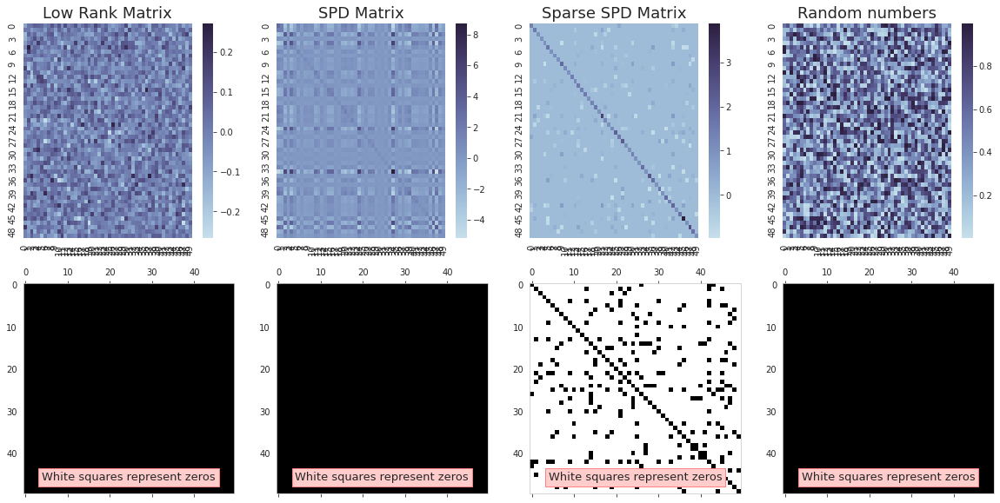

In [27]:
fig, axes = plt.subplots(2, 4, figsize=(20, 10))

my_cmap = sns.color_palette("ch:s=.25,rot=-.25", as_cmap=True)

lrm_df = pd.DataFrame(datasets.make_low_rank_matrix(n_samples=50, n_features=50, effective_rank=10, tail_strength=0.5, random_state=42))
sns.heatmap(lrm_df, xticklabels=lrm_df.columns, annot=False, linewidths=0.0, ax=axes[0][0], cbar=True, cmap=my_cmap)
axes[1][0].spy(lrm_df, precision=0.0)
axes[1][0].grid(False)
axes[0][0].set_title("Low Rank Matrix", fontsize=18)

spd_df = pd.DataFrame(datasets.make_spd_matrix(n_dim=50, random_state=42))
sns.heatmap(spd_df, xticklabels=spd_df.columns, annot=False, linewidths=0.0, ax=axes[0][1], cbar=True, cmap=my_cmap)
axes[1][1].spy(spd_df, precision=0.0)
axes[1][1].grid(False)
axes[0][1].set_title("SPD Matrix", fontsize=18)

sspd_df = pd.DataFrame(datasets.make_sparse_spd_matrix(dim=50, alpha=0.95, norm_diag=False, smallest_coef=0.0, largest_coef=1.0, random_state=42))
sns.heatmap(sspd_df, xticklabels=sspd_df.columns, annot=False, linewidths=0.0, ax=axes[0][2], cbar=True, cmap=my_cmap)
axes[1][2].spy(sspd_df, precision=0.0)
axes[1][2].grid(False)
axes[0][2].set_title("Sparse SPD Matrix", fontsize=18)

np.random.seed(3)
rand_df = pd.DataFrame(np.random.rand(50,50))
sns.heatmap(rand_df, xticklabels=rand_df.columns, annot=False, linewidths=0.0, ax=axes[0][3], cbar=True, cmap=my_cmap)
axes[1][3].spy(rand_df, precision=0.0)
axes[1][3].grid(False)
axes[0][3].set_title("Random numbers", fontsize=18)

bbox = dict(boxstyle="square", ec=(1., 0.5, 0.5), fc=(1., 0.8, 0.8))
for i in range(4):
    axes[1][i].text(x=0.5, y=0.05, s="White squares represent zeros", ha="center", va="bottom", transform=axes[1][i].transAxes, bbox=bbox, fontsize=13)

plt.show()

## **<span style="font-size:150%"> make_sparse_coded_signal</span>**

### What it is

A sparse signal is a signal which contains only a small number of non-zero elements compared to its dimension.

Sparcity in signals can have multiple uses and advantages. Sparce signals can be encoded in smaller packages and be recovered via signal processing algorithms. This makes it ideal where cost, bandwidth or noise is a huge factor to be considered, such as long-distances communications, biosignal data (EEC/ECG), audiowaves, among many others cases.

Still, scikit-learn's make_sparse_coded_signal, although a welcome addition, is very brief in it's usage, documentation and implementation, so we'll treat it as a bonus.

### Important parameters

- n_samples [int]: Number of samples.
- n_components [int]: Number of components in the dictionary.
- n_features [int]: Number of features in the data.
- n_nonzero_coefs [int]: Number of non-zero coefficients in each sample. This directly influences the sparcity of the data.

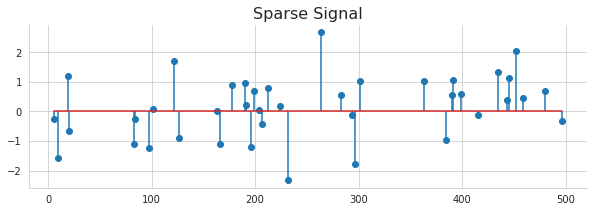

In [28]:
data, dictionary, code = datasets.make_sparse_coded_signal(n_samples=1, n_components=512, n_features=150, n_nonzero_coefs=40, random_state=42)

(idx,) = code.nonzero()

fig, axes = plt.subplots(figsize=(10, 3))
axes.set_title("Sparse signal")
axes.stem(idx, code[idx], use_line_collection=True)

axes.set_title("Sparse Signal", fontsize=16)
axes.spines['right'].set_visible(False)
axes.spines['top'].set_visible(False)

<a id="9"></a>
# <p style="background-color:#56BBD1;font-family:newtimeroman;color:#2E3035;font-size:150%;text-align:center;border-radius:10px 10px;">CONCLUSION</p>

In this project, I explained all of scikit-learn's data generation functions and their major parameters.

I also illustrated most of them using GIFs, aiming to provide easier explanations through data visualization.


**<span style="color:#56BBD1;"> If you liked this Notebook, please do upvote.</span>**

**<span style="color:#56BBD1;">If you have any questions, feel free to comment!</span>**

<a id="10"></a>
# <p style="background-color:#56BBD1;font-family:newtimeroman;color:#2E3035;font-size:150%;text-align:center;border-radius:10px 10px;">REFERENCES</p>

[1] Scikit-Learn 1.0.2 Documentation - Generated datasets


[2] https://archive.ics.uci.edu/ml/datasets/Madelon


[3] J. Friedman, "Multivariate adaptive regression splines", The Annals of Statistics 19 (1), pages 1–67, 1991.